In [1]:
import ast
import glob
import os

import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import skimage
from IPython.core.interactiveshell import InteractiveShell
from tqdm import tqdm

InteractiveShell.ast_node_interactivity = "all"
from scipy import ndimage as ndi
from skimage.feature import canny

## train dataframe

In [2]:
df = pd.read_csv("/app/_data/full_train.csv")
df.head()

,id,class,segmentation,case,day,slice,path,img_name,img_height,img_width,...,min_pixel_value,abs_mean_pixel_value,rel_mean_pixel_value,is_mask,day_monotonic,period,slice_monotonic,num_slices,real_height,real_width
0,case123_day20_slice_0001,large_bowel,NaN,case123,20,1,/app/_data/train/case123/case123_day20/scans/s...,slice_0001_266_266_1.50_1.50,266,266,...,0.0,105.069549,0.041268,False,True,22,True,144.0,399.0,399.0
1,case123_day20_slice_0001,small_bowel,NaN,case123,20,1,/app/_data/train/case123/case123_day20/scans/s...,slice_0001_266_266_1.50_1.50,266,266,...,0.0,105.069549,0.041268,False,True,22,True,144.0,399.0,399.0
2,case123_day20_slice_0001,stomach,NaN,case123,20,1,/app/_data/train/case123/case123_day20/scans/s...,slice_0001_266_266_1.50_1.50,266,266,...,0.0,105.069549,0.041268,False,True,22,True,144.0,399.0,399.0
3,case123_day20_slice_0002,large_bowel,NaN,case123,20,2,/app/_data/train/case123/case123_day20/scans/s...,slice_0002_266_266_1.50_1.50,266,266,...,0.0,126.488453,0.042675,False,True,22,True,144.0,399.0,399.0
4,case123_day20_slice_0002,small_bowel,NaN,case123,20,2,/app/_data/train/case123/case123_day20/scans/s...,slice_0002_266_266_1.50_1.50,266,266,...,0.0,126.488453,0.042675,False,True,22,True,144.0,399.0,399.0


In [6]:
df["npy_path"] = "/app/_data/3D_npy_bf/" + df["id"] + ".npy"

# Edge detection

In [7]:
def rle_decode(mask_array, img_shape):
    h, w = img_shape
    img_mask = np.zeros(h * w)
    rle_mask = np.array(mask_array.split(), dtype="int")
    starts = rle_mask[0::2] - 1
    ends = rle_mask[1::2] + starts
    for start, end in zip(starts, ends):
        img_mask[start:end] = 1
    return img_mask.reshape([h, w])


def load_img(path):
    if ".npy" in path:
        img = np.load(path)
        img = img[:, :, :3].astype("float32")
    else:
        img = cv2.imread(path, cv2.IMREAD_UNCHANGED).astype("float32")
    img -= img.min()
    img /= img.max()
    return img


def get_img_mask(df, img_id):
    id_df = df.query("id == @img_id")
    img = load_img(id_df["path"].values[0]).astype("float32")
    img -= img.min()
    img /= img.max()
    h, w = img.shape[:2]
    mask = np.zeros((h, w, 3), dtype=np.uint8)
    for n, label in enumerate(["large_bowel", "small_bowel", "stomach"]):
        rle = id_df[id_df["class"] == label]["segmentation"].values[0]
        if rle == rle:
            mask[:, :, n] = rle_decode(rle, (h, w))
    return img, mask

In [8]:
idxs = df[(df["rel_mean_pixel_value"] < 0.03) & (df["is_mask"])]["id"].unique()
img, mask = get_img_mask(df, img_id=idxs[22])
img3d = load_img(df[df["id"] == idxs[22]]["npy_path"].values[0])

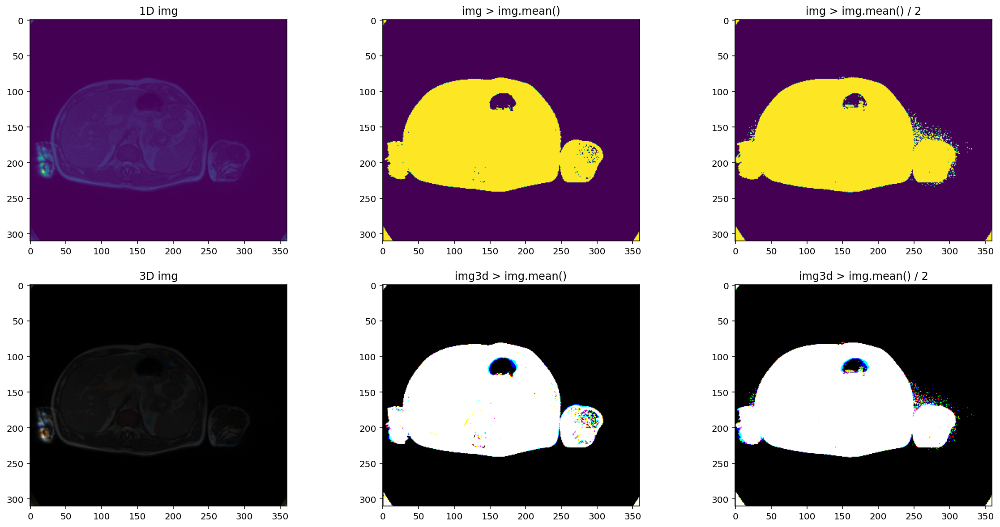

In [9]:
plt.figure(figsize=(20, 10))
plt.subplot(2, 3, 1)
plt.title("1D img")
plt.imshow(img)
plt.subplot(2, 3, 2)
plt.title("img > img.mean()")
plt.imshow(img > img.mean())
plt.subplot(2, 3, 3)
plt.title("img > img.mean() / 2")
plt.imshow(img > img.mean() / 2)
plt.subplot(2, 3, 4)
plt.title("3D img")
plt.imshow(img3d)
plt.subplot(2, 3, 5)
plt.title("img3d > img.mean()")
plt.imshow((img3d > img.mean()).astype("float32"))
plt.subplot(2, 3, 6)
plt.title("img3d > img.mean() / 2")
plt.imshow((img3d > img.mean() / 2).astype("float32"))
plt.show();

In [10]:
contours3d = []
contours = skimage.measure.find_contours(img, 0.05)
for i in range(3):
    contours3d.extend(skimage.measure.find_contours(img3d[:, :, i], 0.05))

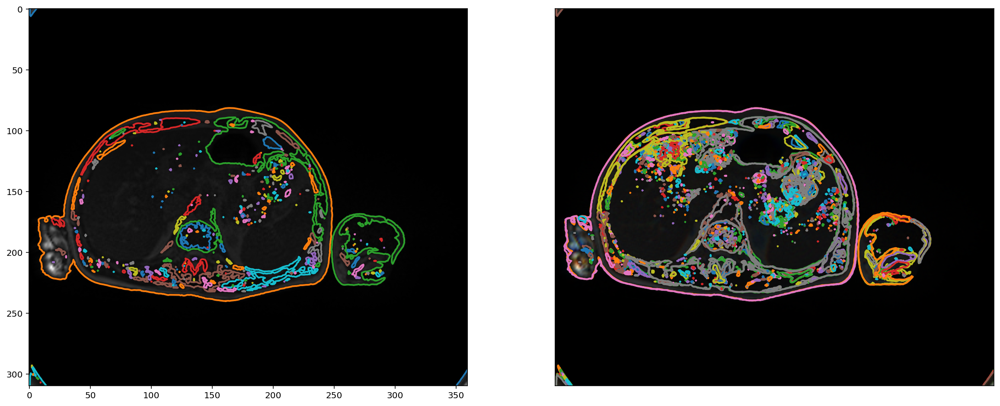

In [11]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(img, cmap=plt.cm.gray)

for contour in contours:
    ax[0].plot(contour[:, 1], contour[:, 0], linewidth=2)
ax[1].imshow(img3d, cmap=plt.cm.gray)
plt.xticks([])
plt.yticks([])
for contour in contours3d:
    ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2)

plt.xticks([])
plt.yticks([])
plt.show();

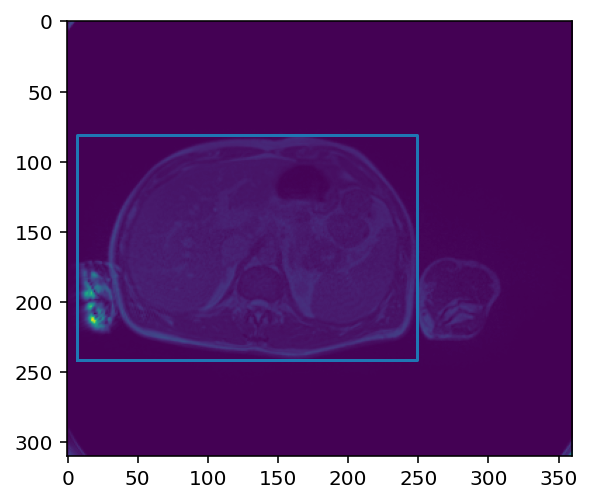

In [12]:
c_id = np.argmax([len(x) for x in contours])
contour = contours[c_id]

ymin, ymax = np.floor(contour[:, 0].min()), np.ceil(contour[:, 0].max())
xmin, xmax = np.floor(contour[:, 1].min()), np.ceil(contour[:, 1].max())

plt.imshow(img)
plt.plot([xmin, xmin, xmax, xmax, xmin], [ymax, ymin, ymin, ymax, ymax])
plt.show();

In [13]:
# img3d = np.load(df[df["id"] == idxs[11]]["npy_path"].values[0]).astype("float32")
img3d = load_img(df.sample()["npy_path"].values[0])
img = (img3d * 255).astype("uint8")
img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
img = np.where(img > img.mean() * 2, 1, 0)
label_objects, _ = ndi.label(img)
sizes = np.bincount(label_objects.ravel())
sizes[0] = 0
mask_sizes = sizes == sizes.max()
mask_sizes[0] = 0
img_cleaned = mask_sizes[label_objects]

In [14]:
ymin, ymax = (
    np.argwhere(img_cleaned == 1)[:, 0].min(),
    np.argwhere(img_cleaned == 1)[:, 0].max(),
)
xmin, xmax = (
    np.argwhere(img_cleaned == 1)[:, 1].min(),
    np.argwhere(img_cleaned == 1)[:, 1].max(),
)

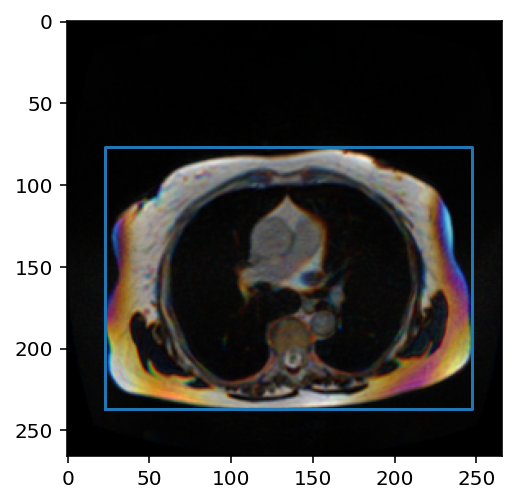

In [15]:
plt.imshow(img3d)
plt.plot([xmin, xmin, xmax, xmax, xmin], [ymax, ymin, ymin, ymax, ymax])
plt.show();

In [16]:
def find_cont(img):
    img = (img * 255).astype("uint8")
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    img_mean = img.mean()
    if img_mean > 30:
        img = np.where(img > img_mean / 2, 1, 0)
    else:
        img = np.where(img > img_mean, 1, 0)
    label_objects, _ = ndi.label(img)
    sizes = np.bincount(label_objects.ravel())
    sizes[0] = 0
    mask_sizes = sizes == sizes.max()
    mask_sizes[0] = 0
    img_cleaned = mask_sizes[label_objects]
    ymin, ymax = (
        np.argwhere(img_cleaned == 1)[:, 0].min(),
        np.argwhere(img_cleaned == 1)[:, 0].max(),
    )
    xmin, xmax = (
        np.argwhere(img_cleaned == 1)[:, 1].min(),
        np.argwhere(img_cleaned == 1)[:, 1].max(),
    )
    return xmin, ymin, xmax, ymax

## check for images with different brightness

In [17]:
df["rel_mean_pixel_value"].describe()

count    115488.000000
mean          0.113794
std           0.047901
min           0.005592
25%           0.077228
50%           0.108853
75%           0.145722
max           0.299011
Name: rel_mean_pixel_value, dtype: float64

## dark images

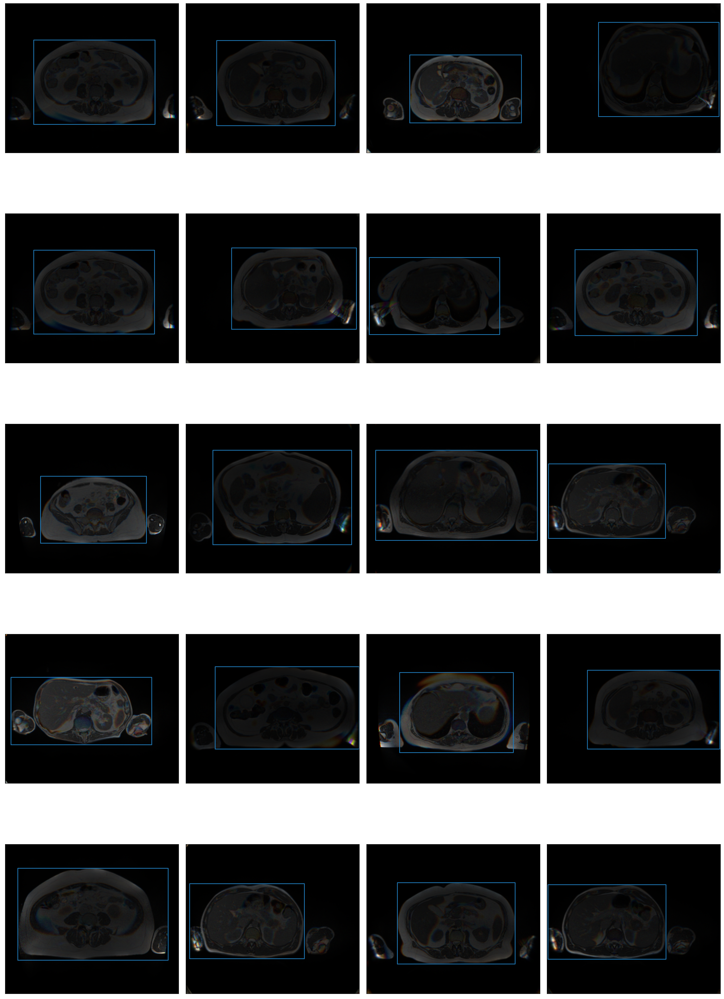

In [16]:
idxs = df[(df["rel_mean_pixel_value"] < 0.05) & (df["is_mask"])]["id"].unique()

plt.figure(figsize=(20, 30))
for n in range(20):
    ids = idxs[np.random.randint(len(idxs))]
    img = load_img(df[df["id"] == ids]["npy_path"].values[0])
    xmin, ymin, xmax, ymax = find_cont(img)
    plt.subplot(5, 4, n + 1)
    plt.imshow(img)
    plt.plot([xmin, xmin, xmax, xmax, xmin], [ymax, ymin, ymin, ymax, ymax])
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show();

## mean images

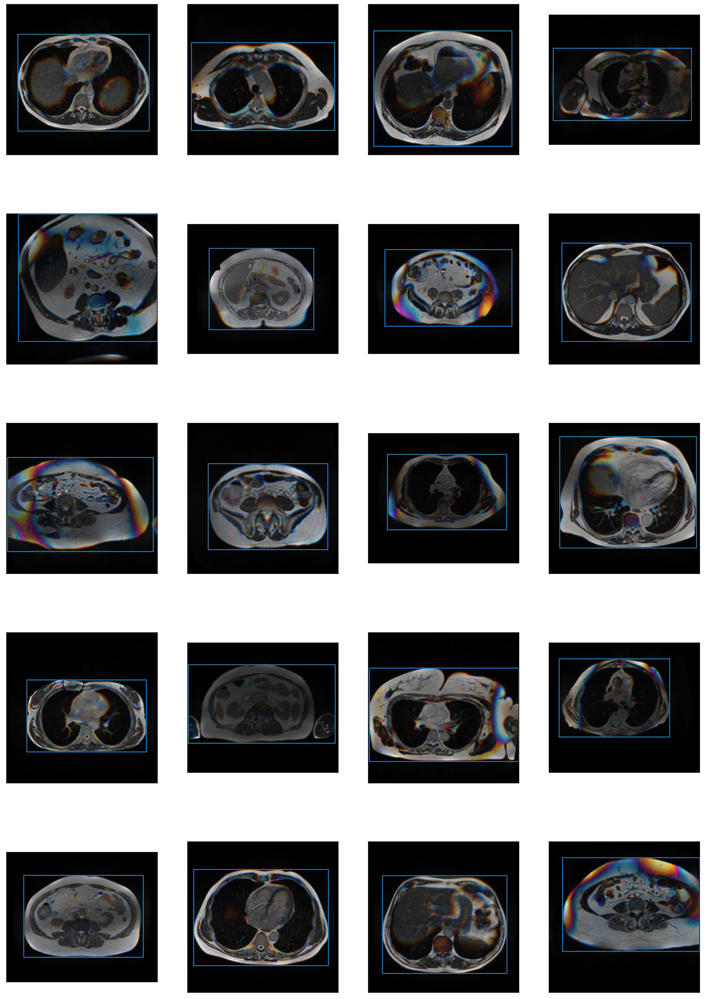

In [17]:
idxs = df[(df["rel_mean_pixel_value"] > 0.05) & (df["rel_mean_pixel_value"] < 0.2)][
    "id"
].unique()
plt.figure(figsize=(20, 30))
for n in range(20):
    ids = idxs[np.random.randint(len(idxs))]
    img = load_img(df[df["id"] == ids]["npy_path"].values[0])
    xmin, ymin, xmax, ymax = find_cont(img)
    plt.subplot(5, 4, n + 1)
    plt.imshow(img)
    plt.plot([xmin, xmin, xmax, xmax, xmin], [ymax, ymin, ymin, ymax, ymax])
    plt.xticks([])
    plt.yticks([])
plt.show();

## bright images

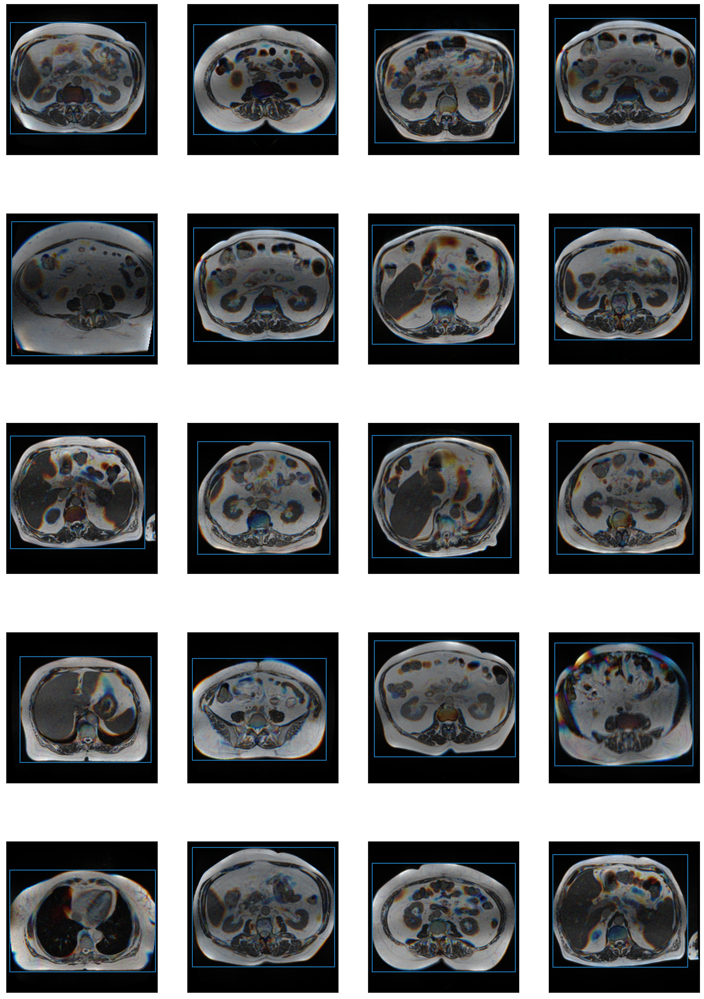

In [18]:
idxs = df[df["rel_mean_pixel_value"] > 0.2]["id"].unique()
plt.figure(figsize=(20, 30))
for n in range(20):
    ids = idxs[np.random.randint(len(idxs))]
    img = load_img(df[df["id"] == ids]["npy_path"].values[0])
    xmin, ymin, xmax, ymax = find_cont(img)
    plt.subplot(5, 4, n + 1)
    plt.imshow(img)
    plt.plot([xmin, xmin, xmax, xmax, xmin], [ymax, ymin, ymin, ymax, ymax])
    plt.xticks([])
    plt.yticks([])
plt.show();

## all images

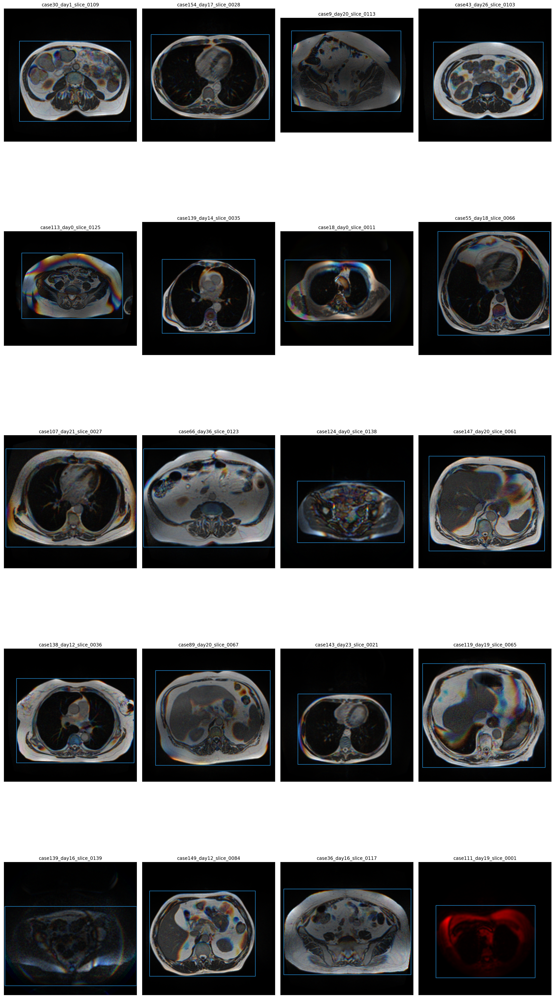

In [19]:
idxs = df["id"].unique()

plt.figure(figsize=(20, 40))
for n in range(20):
    ids = idxs[np.random.randint(idxs.shape[0])]
    img = load_img(df[df["id"] == ids]["npy_path"].values[0])
    xmin, ymin, xmax, ymax = find_cont(img)
    plt.subplot(5, 4, n + 1)
    plt.title(ids)
    plt.imshow(img)
    plt.plot([xmin, xmin, xmax, xmax, xmin], [ymax, ymin, ymin, ymax, ymax])
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show();

## crop and resize images based on found boundaries

In [18]:
def load_6d_img(path):
    img = np.load(path).astype("float32")
    img[:, :, :3] -= img[:, :, :3].min()
    img[:, :, :3] /= img[:, :, :3].max()
    return img

In [20]:
def crop_and_resize(img, img_size):
    xmin, ymin, xmax, ymax = find_cont(img[:, :, :3])
    cropped = img[ymin:ymax, xmin:xmax, :]
    max_size = np.max((xmax - xmin, ymax - ymin))
    x_pad = max_size - cropped.shape[1]
    y_pad = max_size - cropped.shape[0]
    x_pad = x_pad if x_pad > 0 else 0
    y_pad = y_pad if y_pad > 0 else 0
    left_pad = x_pad // 2
    right_pad = x_pad - left_pad
    top_pad = y_pad // 2
    bottom_pad = y_pad - top_pad
    padded = np.pad(
        cropped,
        ((top_pad, bottom_pad), (left_pad, right_pad), (0, 0)),
        mode="constant",
        constant_values=0,
    )
    resized = cv2.resize(padded, img_size, interpolation=cv2.INTER_LINEAR)
    resized[:,:,3:] = np.where(resized[:,:,3:]>0, 1, 0)
    return resized, (
        max_size,
        img.shape[:2],
        (top_pad, max_size - bottom_pad, left_pad, max_size - right_pad),
        (xmin, ymin, xmax, ymax),
    )

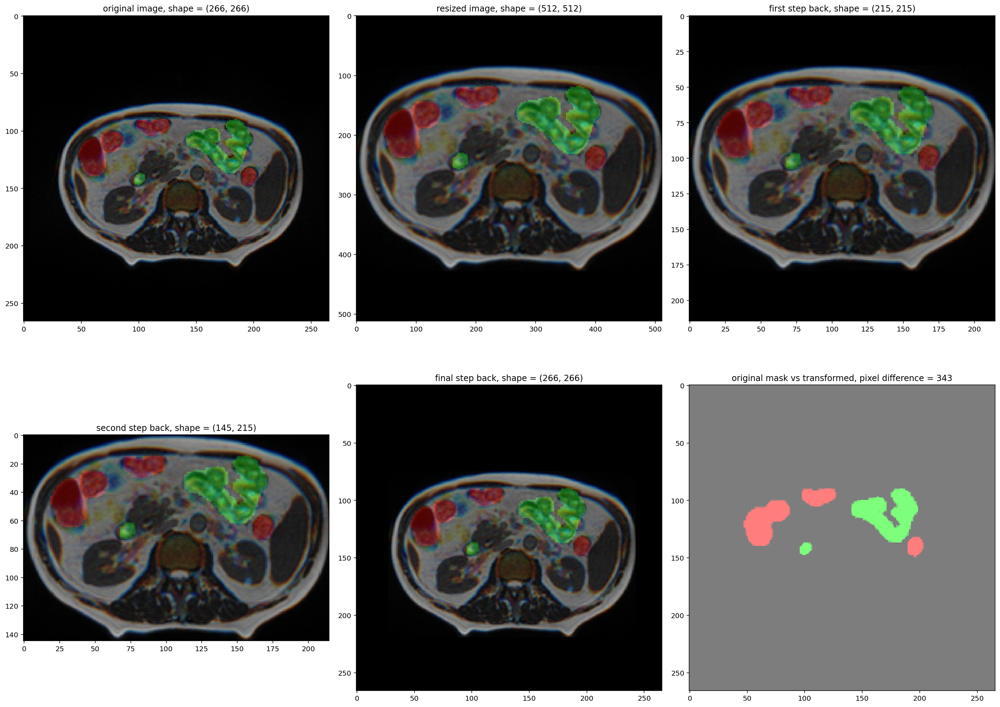

In [21]:
img = load_6d_img(df[df["is_mask"]].sample()["npy_path"].values[0])
plt.figure(figsize=(20, 15))
plt.subplot(2, 3, 1)
plt.title(f"original image, shape = {img.shape[:2]}")
plt.imshow(img[:, :, :3])
plt.imshow(img[:, :, 3:], alpha=0.3)
resized, meta = crop_and_resize(img, img_size=(512, 512))
plt.subplot(2, 3, 2)
plt.title(f"resized image, shape = {resized.shape[:2]}")
plt.imshow(resized[:, :, :3])
plt.imshow(resized[:, :, 3:], alpha=0.3)
max_crop_size = meta[0]
orig_size = meta[1]
pad = meta[2]
xmin, ymin, xmax, ymax = meta[3]
img0 = cv2.resize(
    resized, (max_crop_size, max_crop_size), interpolation=cv2.INTER_LINEAR
)
plt.subplot(2, 3, 3)
plt.title(f"first step back, shape = {img0.shape[:2]}")
plt.imshow(img0[:, :, :3])
plt.imshow(img0[:, :, 3:], alpha=0.3)
img0 = img0[pad[0] : pad[1], pad[2] : pad[3], :]
plt.subplot(2, 3, 4)
plt.title(f"second step back, shape = {img0.shape[:2]}")
plt.imshow(img0[:, :, :3])
plt.imshow(img0[:, :, 3:], alpha=0.3)
img1 = np.zeros((orig_size[0], orig_size[1], 6))
img1[ymin:ymax, xmin:xmax, :] = img0
plt.subplot(2, 3, 5)
plt.title(f"final step back, shape = {img1.shape[:2]}")
plt.imshow(img1[:, :, :3])
plt.imshow(img1[:, :, 3:], alpha=0.3)
plt.subplot(2, 3, 6)
mask = np.where(img1[:, :, 3:] > 0.5, 1, 0)
plt.title(
    f"original mask vs transformed, pixel difference = {np.sum(img[:, :, 3:] != mask)}"
)
plt.imshow(img[:, :, 3:], alpha=0.3)
plt.imshow(mask.astype("float32"), alpha=0.3)
plt.tight_layout()
plt.show();

In [22]:
def resize_to_origin(img, max_crop_size, orig_size, pad, crop_coords):
    resized = cv2.resize(
        img, (max_crop_size, max_crop_size), interpolation=cv2.INTER_LINEAR
    )
    xmin, ymin, xmax, ymax = crop_coords
    crop_img = resized[pad[0] : pad[1], pad[2] : pad[3], :]

    new_img = np.zeros((orig_size[0], orig_size[1], 6))
    new_img[ymin:ymax, xmin:xmax, :] = crop_img
    new_img[:, :, 3:] = np.where(new_img[:, :, 3:] > 0.5, 1, 0)
    return new_img

In [23]:
def resize_mask_to_origin(mask, max_crop_size, orig_size, pad, crop_coords):
    mask = cv2.resize(
        mask, (max_crop_size, max_crop_size), interpolation=cv2.INTER_LINEAR
    )
    xmin, ymin, xmax, ymax = crop_coords
    crop_mask = mask[pad[0] : pad[1], pad[2] : pad[3], :]
    new_mask = np.zeros((orig_size[0], orig_size[1], 6))
    new_mask[ymin:ymax, xmin:xmax, :] = crop_mask
    new_mask = np.where(new_mask > 0.5, 1, 0)
    return new_mask

In [24]:
img = load_6d_img(df[df["is_mask"]].sample()["npy_path"].values[0])
resized, meta = crop_and_resize(img, img_size=(512, 512))
max_crop_size, orig_size, pads, crop_coords = meta
res_img = resize_to_origin(resized, max_crop_size, orig_size, pads, crop_coords)

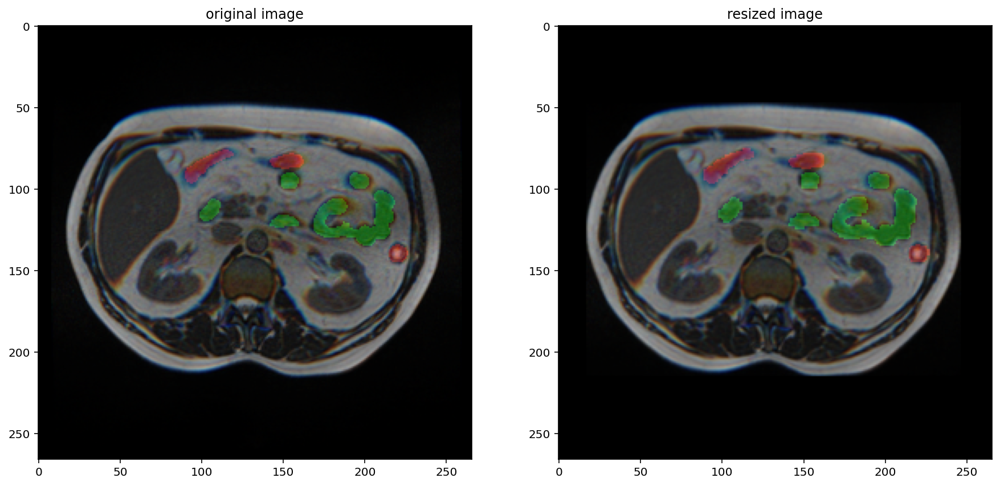

In [25]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 2, 1)
plt.title("original image")
plt.imshow(img[:, :, :3])
plt.imshow(img[:, :, 3:], alpha=0.3)
plt.subplot(1, 2, 2)
plt.title("resized image")
plt.imshow(res_img[:, :, :3])
plt.imshow(res_img[:, :, 3:], alpha=0.3)
plt.show();

In [26]:
np.sum(img[:, :, 3:]!=res_img[:, :, 3:])

328

In [27]:
resized[:,:,3:].max()

1.0

## save npy

In [28]:
npy_paths = glob.glob('/app/_data/3D_npy_bf/*.npy')

In [29]:
new_path = '/app/_data/3Dnpy_512_bf/'

In [30]:
os.makedirs(new_path, exist_ok=True)

In [31]:
for path in tqdm(npy_paths):
    img = load_6d_img(path)
    img_name = path.split('/')[-1]
    resized, meta = crop_and_resize(img, img_size=(512, 512))
    resized[:,:,:3] -= resized[:,:,:3].min()
    resized[:,:,:3] /= resized[:,:,:3].max()
    np.save(os.path.join(new_path, img_name), resized)

100% 38496/38496 [30:06<00:00, 21.31it/s]


In [32]:
img = np.load(os.path.join(new_path, img_name))

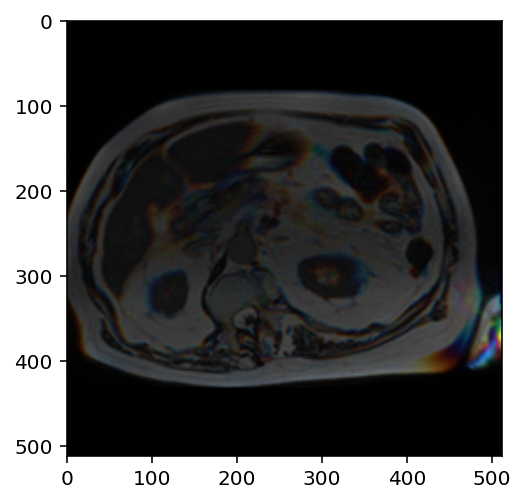

In [33]:
plt.imshow(img[:,:,:3])

In [34]:
img[:,:,:3].max()

1.0

In [35]:
img.shape

(512, 512, 6)

In [37]:
import shutil
shutil.rmtree('/app/_data/models/deeplab_fold_1_two_sided_seed_42_seq_2')